In [1]:
import sys 
sys.path.append('/ai-data/chest/kjs2109/baseline/detectron2-baseline') 
print(sys.path)
from inference.inference_model import InferenceModel 

['/ai-data/chest/kjs2109/baseline/detectron2-baseline/test', '/home/kjs2109/.conda/envs/deepai-kjs/lib/python39.zip', '/home/kjs2109/.conda/envs/deepai-kjs/lib/python3.9', '/home/kjs2109/.conda/envs/deepai-kjs/lib/python3.9/lib-dynload', '', '/home/kjs2109/.local/lib/python3.9/site-packages', '/home/kjs2109/.conda/envs/deepai-kjs/lib/python3.9/site-packages', '/ai-data/env_setup/detectron2', '/ai-data/chest/kjs2109/baseline/detectron2-baseline']


/home/kjs2109/.conda/envs/deepai-kjs/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import torch 

CONFIG_DICT = {
    'weight_path': '/ai-data/chest/kjs2109/baseline/detectron2-baseline/weight_dir/MRCNN/MY_ann_MRCNN_BORA_EVAL_1Findings_4gpus_512bs_8workers_MRCNN_1024_0.0001LR_WCLR_mask_rcnn_R_50_FPN_3x_gn/model_best_0.1318.pth', 
    'model_zoo_config': 'Misc/mask_rcnn_R_50_FPN_3x_gn.yaml',
    'input_min_size_test': 1024, 
    'input_max_size_test': 1024, 
    'model_roi_heads_batch': 512, 
    'model_roi_heads_threshold': 0.5,
    'CLASSES': ['Pneumothorax'], 
    'device': 'cuda' if torch.cuda.is_available() else 'cpu' 
} 

ann_MRCNN_R_50_model = InferenceModel(CONFIG_DICT) 
ann_MRCNN_R_50_model 

In [3]:
from inference.inference_model import plot_inference_result 

In [4]:
import pandas as pd 

total_image_df = pd.read_csv('/ai-data/chest/kjs2109/private_data/total_image_df_v1.csv') 
print(len(total_image_df)) 

over_5_disease_df = pd.read_csv('/ai-data/chest/kjs2109/private_data/over_5_disease_df.csv')
print(len(over_5_disease_df)) 

64852
487


### ann 
* pneumothrax 데이터로만 학습한 경우 pneumothrax를 과하게 예측하는 경향이 있음 -> FP가 많음

  0%|          | 0/9 [00:00<?, ?it/s]/home/kjs2109/.conda/envs/deepai-kjs/lib/python3.9/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
100%|██████████| 9/9 [00:13<00:00,  1.50s/it]


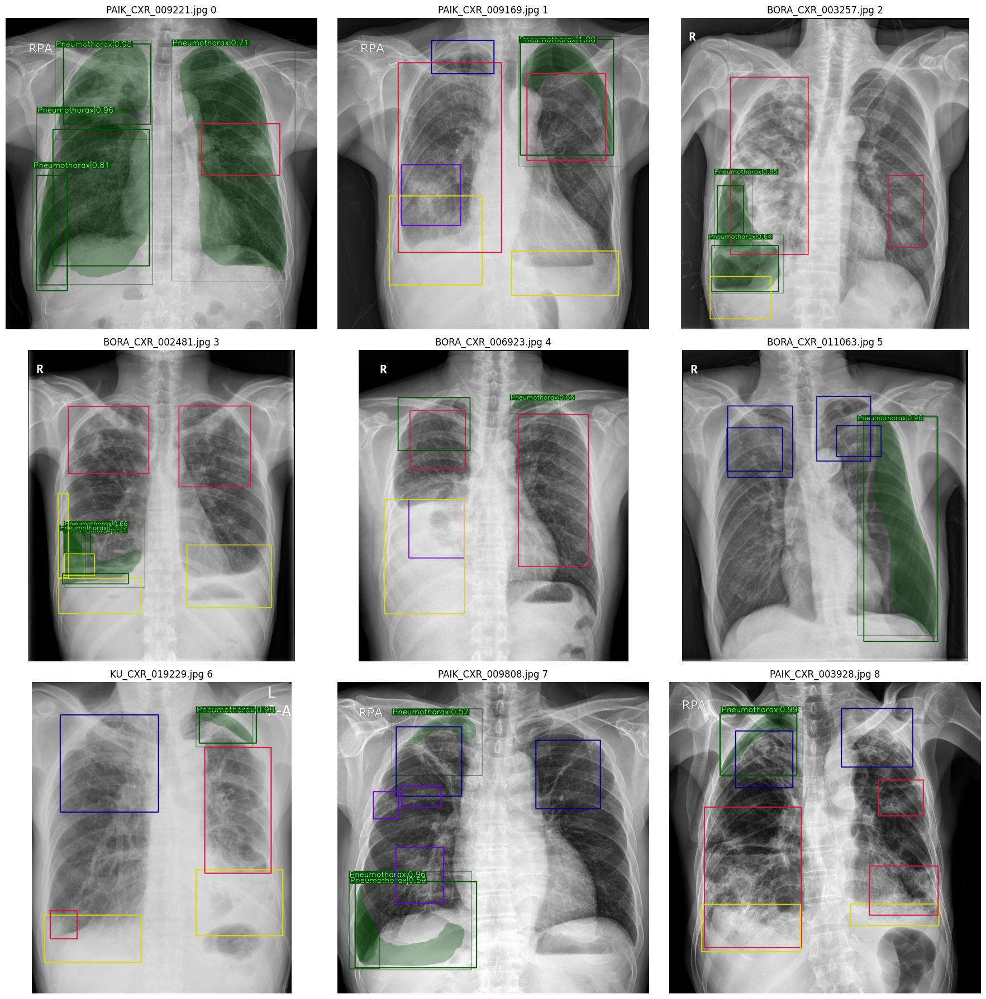

In [5]:
import random 
import pandas as pd 

 
pneumothorax_df = over_5_disease_df[over_5_disease_df['pneumothorax'] >= 1]  

random.seed(42)               
image_fnames = random.sample(list(pneumothorax_df['image_fname']), 9) 

plot_inference_result(ann_MRCNN_R_50_model, image_fnames, gt=True, mode=['mask', 'box'], threshold=0.5) 

100%|██████████| 9/9 [00:11<00:00,  1.31s/it]


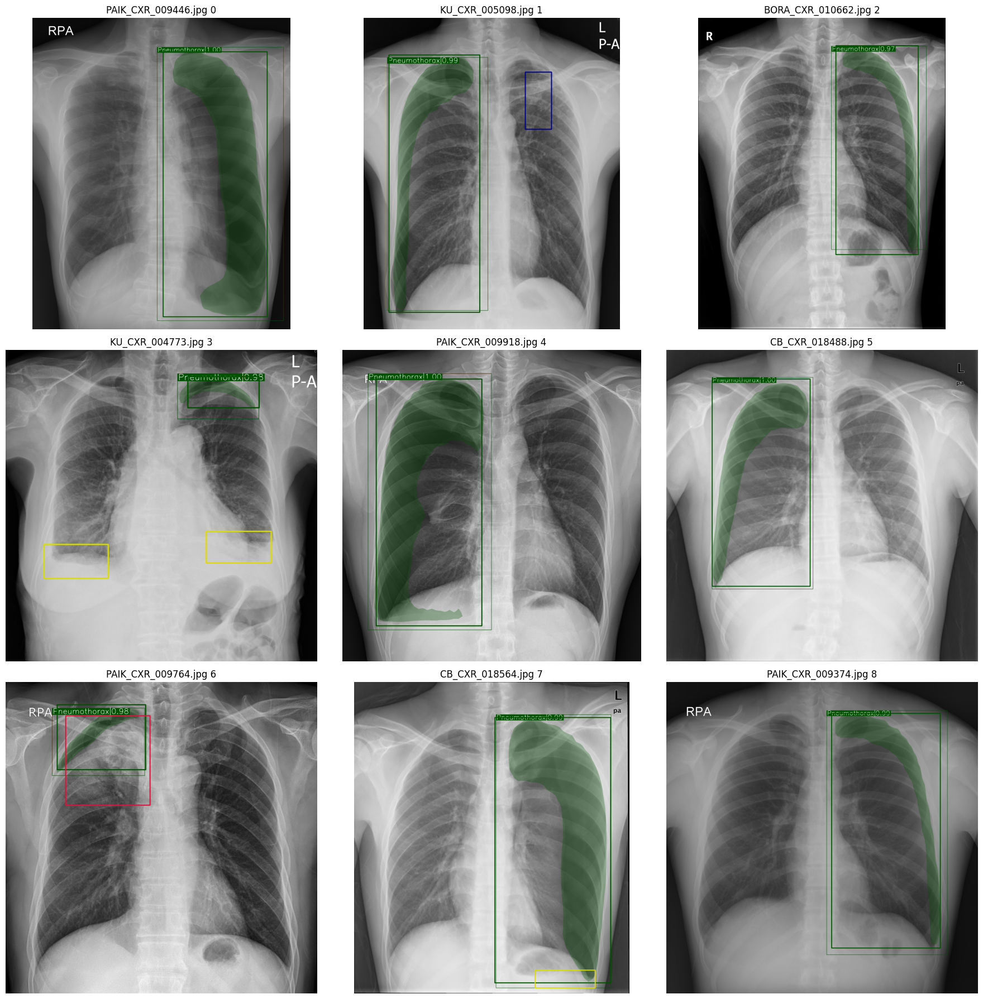

In [6]:
random.seed(42)               
total_pneumothorax_df = total_image_df[total_image_df['pneumothorax'] >= 1]  
image_fnames = random.sample(list(total_pneumothorax_df['image_fname']), 9) 

plot_inference_result(ann_MRCNN_R_50_model, image_fnames, gt=True, mode=['mask', 'box'], threshold=0.5) 

  0%|          | 0/9 [00:00<?, ?it/s]

100%|██████████| 9/9 [00:12<00:00,  1.34s/it]


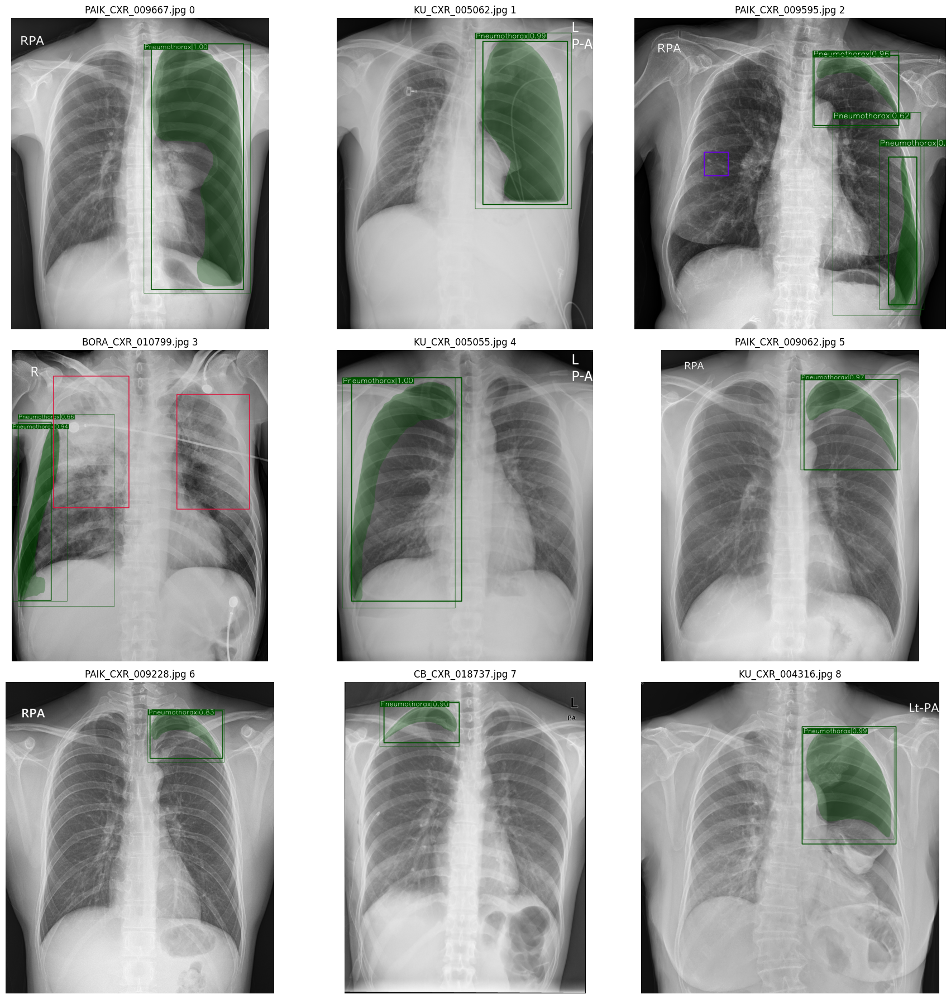

In [7]:
random.seed(50)               
total_pneumothorax_df = total_image_df[total_image_df['pneumothorax'] >= 1]  
image_fnames = random.sample(list(total_pneumothorax_df['image_fname']), 9) 

plot_inference_result(ann_MRCNN_R_50_model, image_fnames, gt=True, mode=['mask', 'box'], threshold=0.5) 

100%|██████████| 9/9 [00:11<00:00,  1.23s/it]


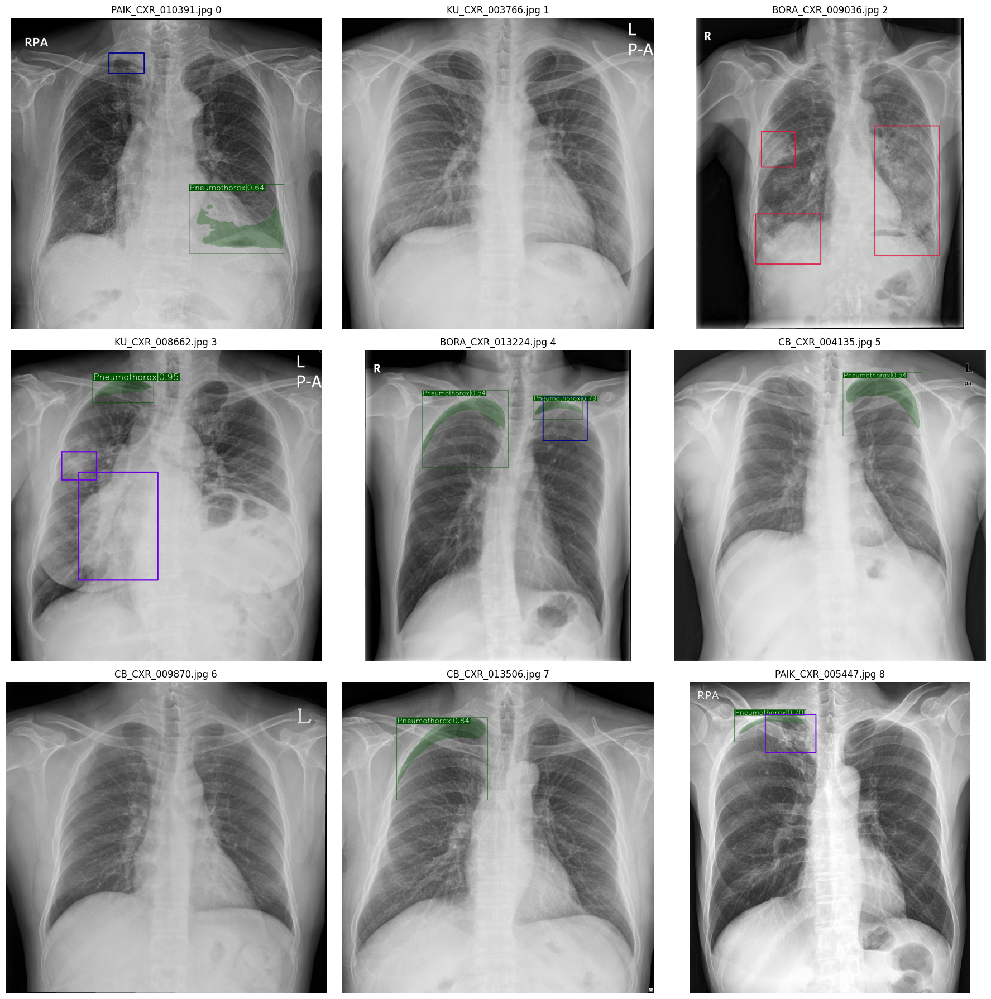

In [9]:
random.seed(42)                
image_fnames = random.sample(list(total_image_df['image_fname']), 9) 

plot_inference_result(ann_MRCNN_R_50_model, image_fnames, gt=True, mode=['mask', 'box'], threshold=0.5) 

100%|██████████| 9/9 [00:57<00:00,  6.36s/it]


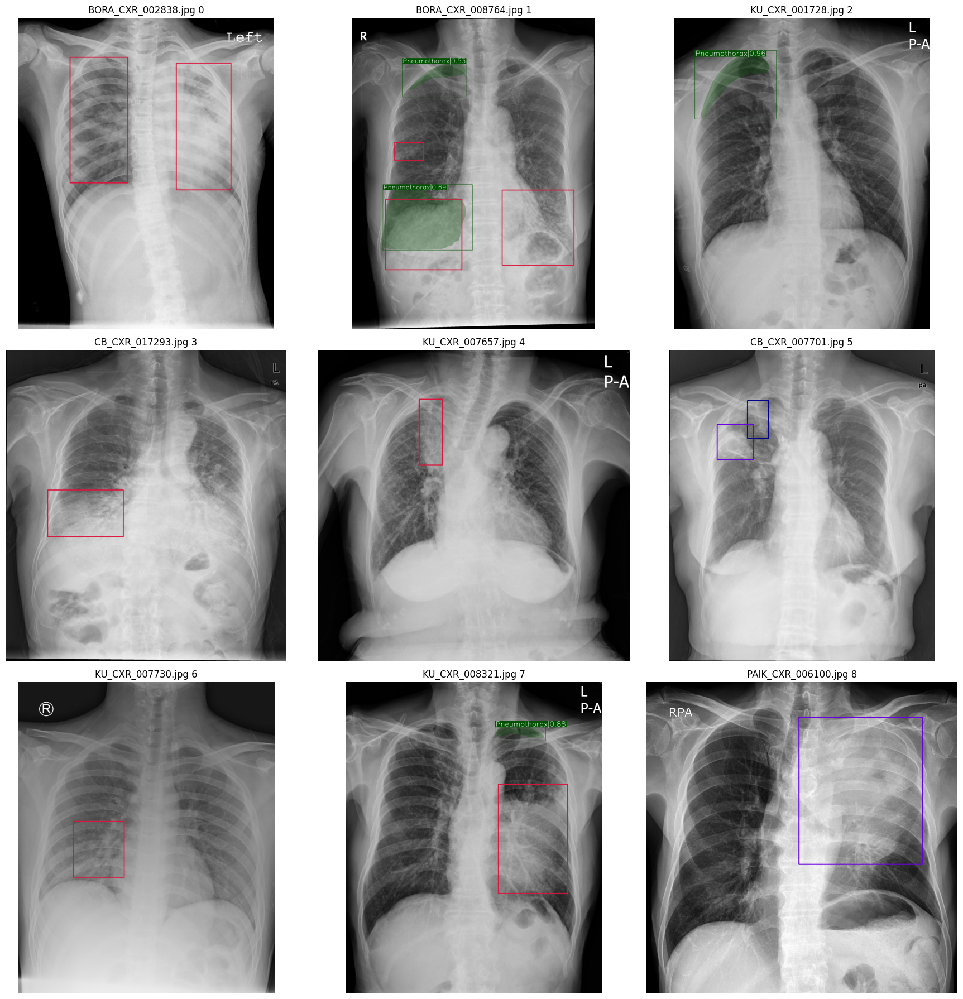

In [13]:
random.seed(54)                
image_fnames = random.sample(list(total_image_df['image_fname']), 9) 

plot_inference_result(ann_MRCNN_R_50_model, image_fnames, gt=True, mode=['mask', 'box'], threshold=0.5) 

### annv1 
* pneumothorax가 없는 데이터도 같이 학습한 경우 pneumothorax를 예측하지 않는 경우가 많음 -> FN가 많음 

In [10]:
import torch 

CONFIG_DICT = {
    'weight_path': '/ai-data/chest/kjs2109/baseline/detectron2-baseline/weight_dir/Misc/My_annv1_MRCNN_BORA_EVAL_1Findings_3gpus_512bs_8workers_MRCNN_1024_0.0001LR_WCLR_mask_rcnn_R_50_FPN_3x_gn/model_best_0.0001.pth', 
    'model_zoo_config': 'Misc/mask_rcnn_R_50_FPN_3x_gn.yaml',
    'input_min_size_test': 1024, 
    'input_max_size_test': 1024, 
    'model_roi_heads_batch': 512, 
    'model_roi_heads_threshold': 0.5,
    'CLASSES': ['Pneumothorax'], 
    'device': 'cuda' if torch.cuda.is_available() else 'cpu' 
} 

annv1_MRCNN_R_50_model = InferenceModel(CONFIG_DICT) 
annv1_MRCNN_R_50_model 

100%|██████████| 9/9 [00:06<00:00,  1.40it/s]


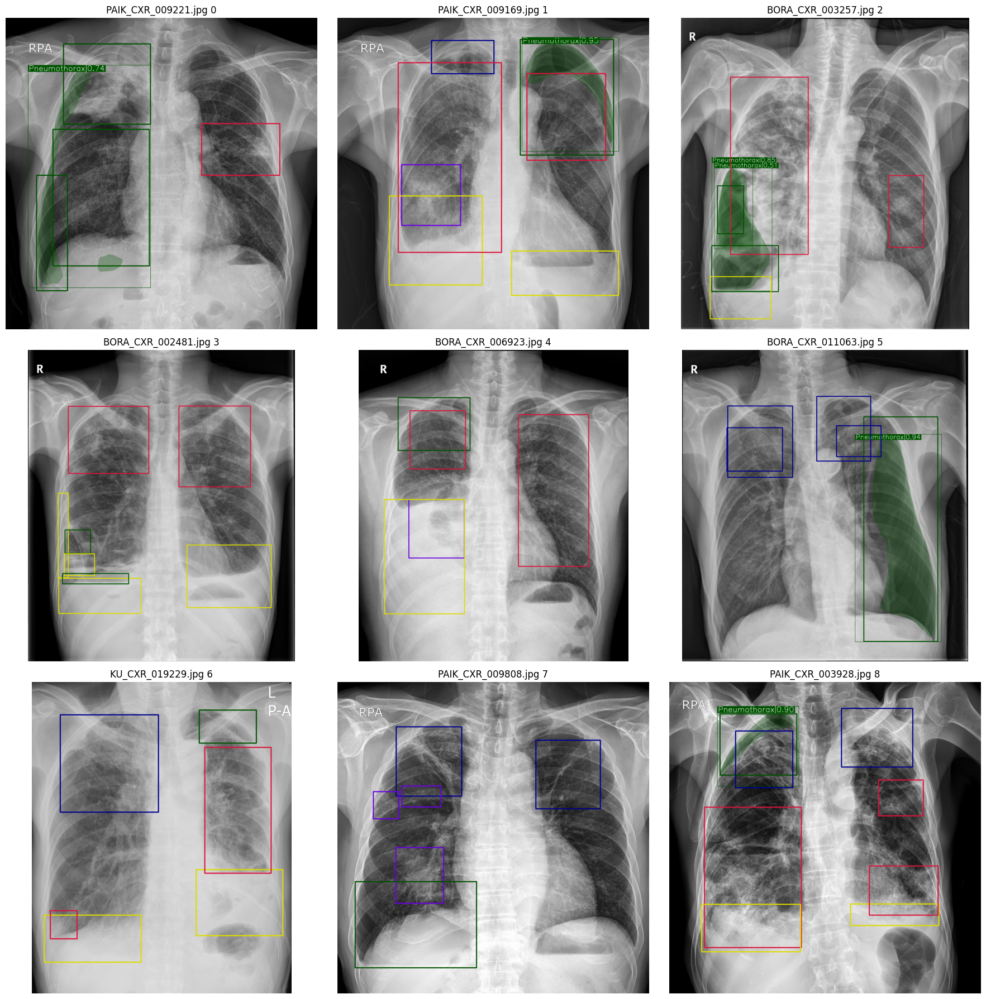

In [28]:
pneumothorax_df = over_5_disease_df[over_5_disease_df['pneumothorax'] >= 1]  

random.seed(42)               
image_fnames = random.sample(list(pneumothorax_df['image_fname']), 9) 

plot_inference_result(annv1_MRCNN_R_50_model, image_fnames, gt=True, mode=['mask', 'box'], threshold=0.5) 

100%|██████████| 9/9 [00:09<00:00,  1.05s/it]


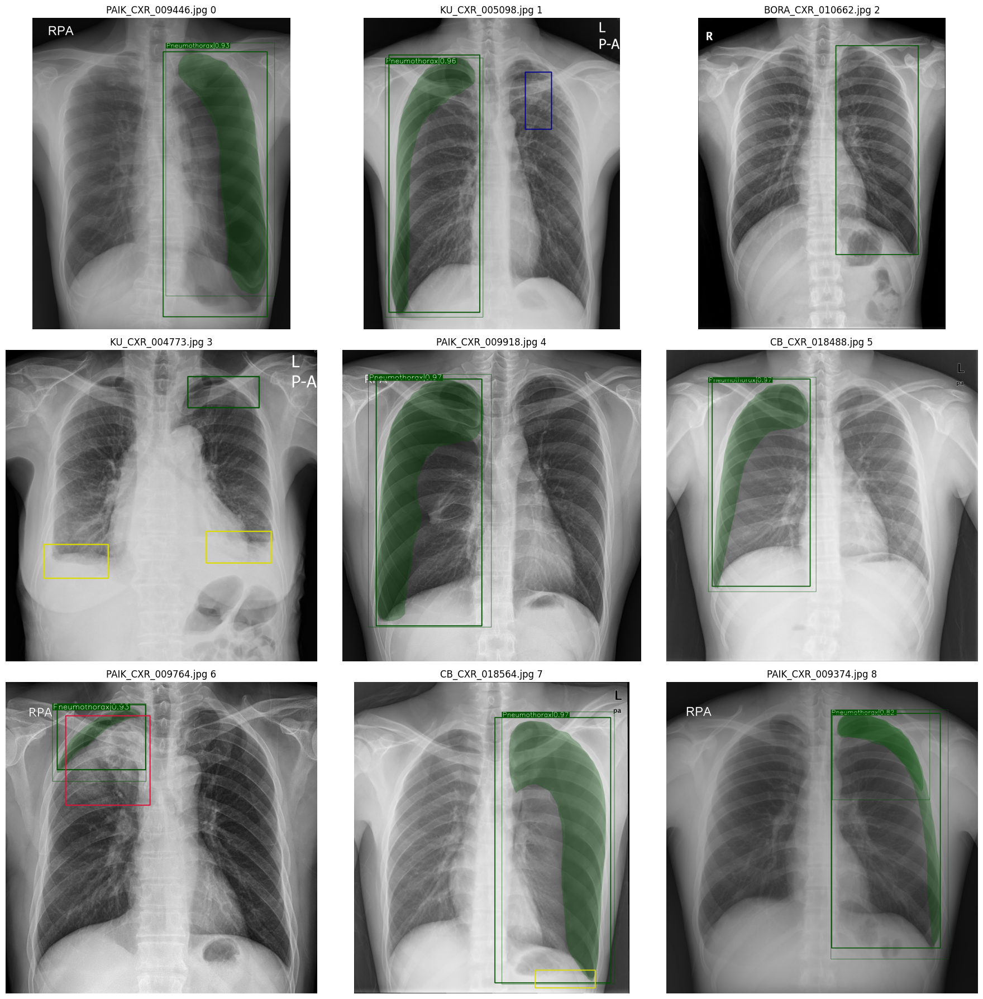

In [29]:
random.seed(42)               
total_pneumothorax_df = total_image_df[total_image_df['pneumothorax'] >= 1]  
image_fnames = random.sample(list(total_pneumothorax_df['image_fname']), 9) 

plot_inference_result(annv1_MRCNN_R_50_model, image_fnames, gt=True, mode=['mask', 'box'], threshold=0.5) 

100%|██████████| 9/9 [00:09<00:00,  1.01s/it]


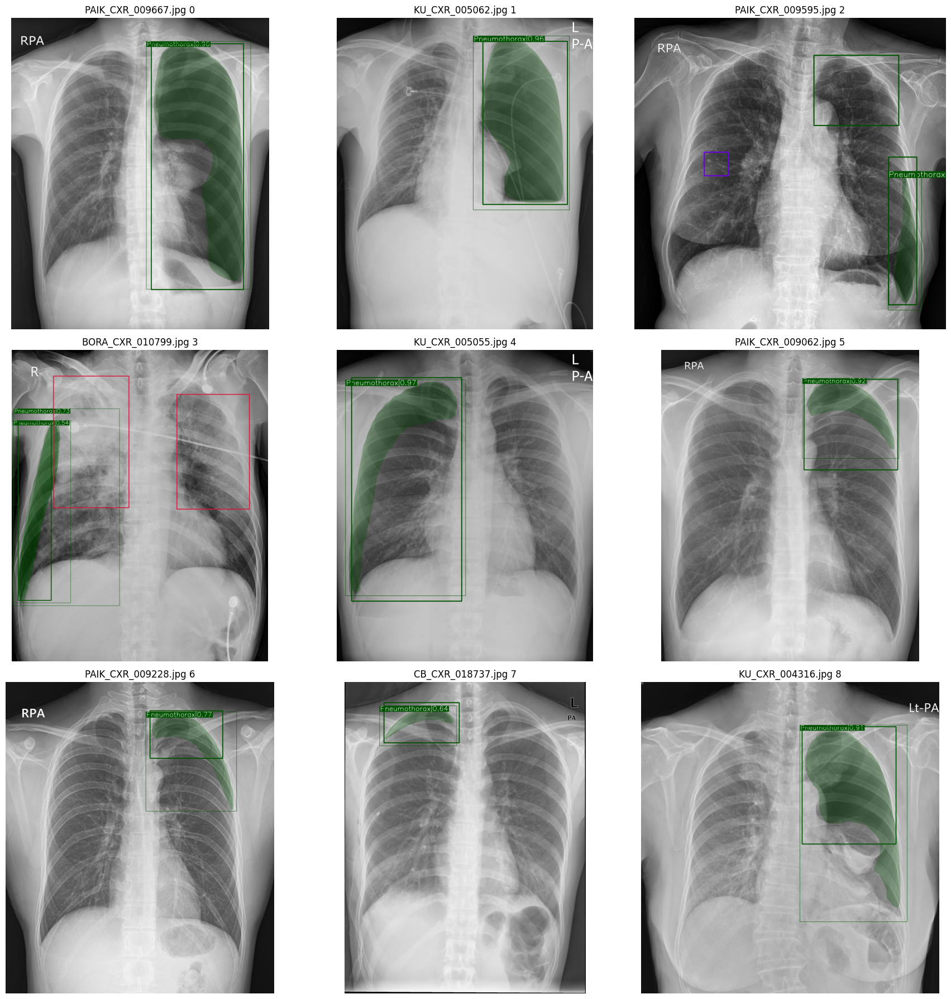

In [30]:
random.seed(50)               
total_pneumothorax_df = total_image_df[total_image_df['pneumothorax'] >= 1]  
image_fnames = random.sample(list(total_pneumothorax_df['image_fname']), 9) 

plot_inference_result(annv1_MRCNN_R_50_model, image_fnames, gt=True, mode=['mask', 'box'], threshold=0.5) 

100%|██████████| 9/9 [00:06<00:00,  1.38it/s]


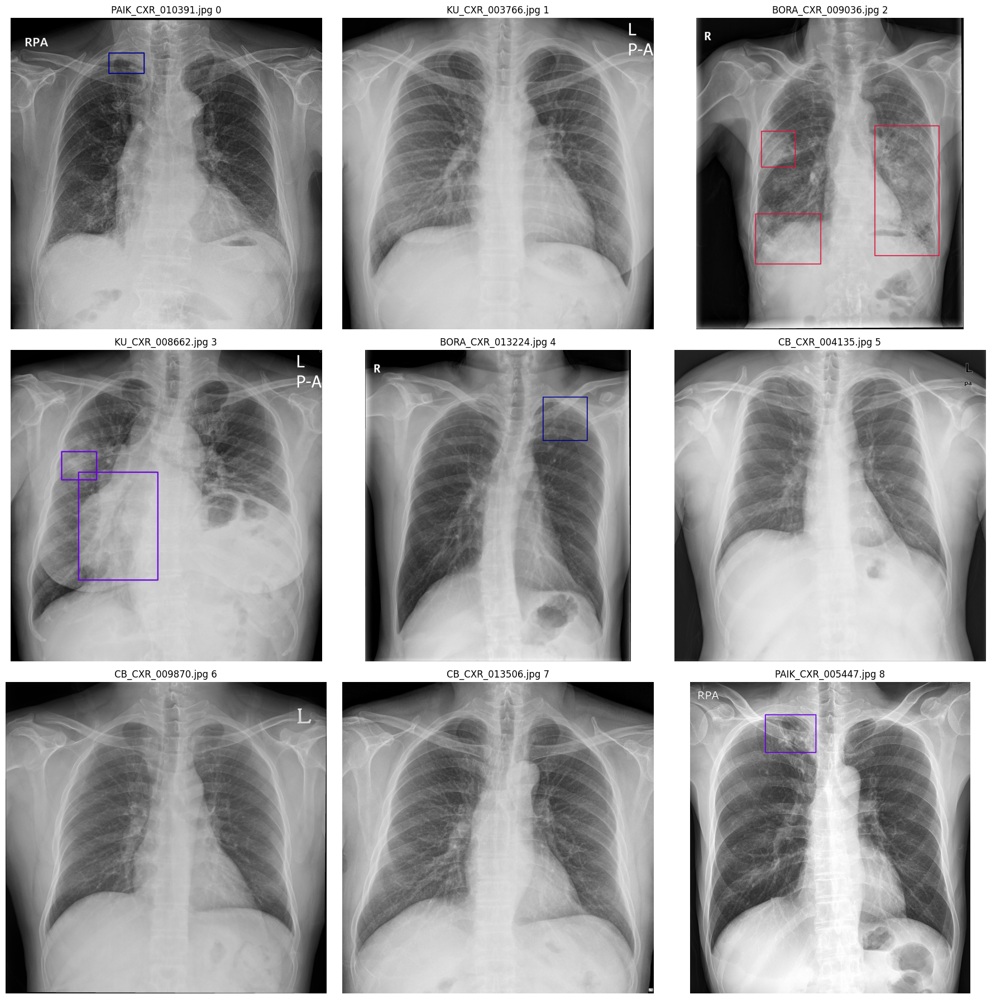

In [11]:
random.seed(42)                
image_fnames = random.sample(list(total_image_df['image_fname']), 9) 

plot_inference_result(annv1_MRCNN_R_50_model, image_fnames, gt=True, mode=['mask', 'box'], threshold=0.5) 

100%|██████████| 9/9 [00:05<00:00,  1.51it/s]


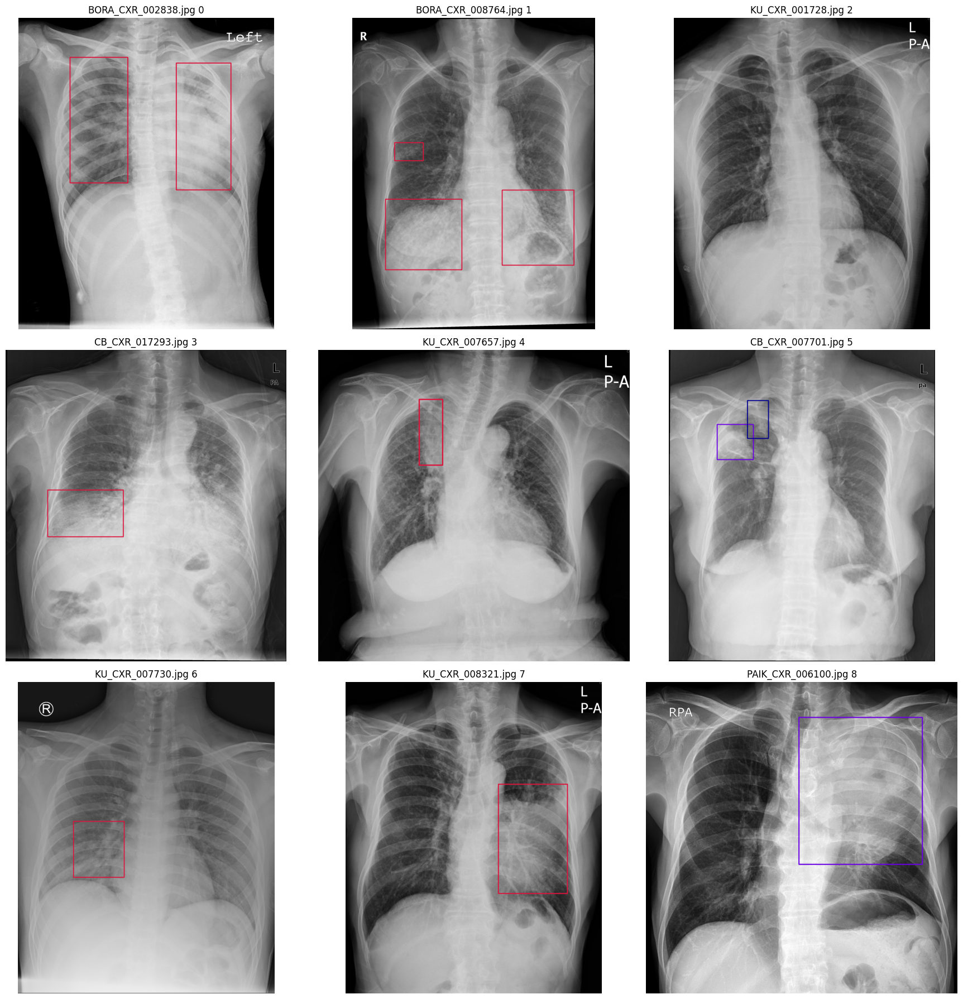

In [14]:
random.seed(54)                
image_fnames = random.sample(list(total_image_df['image_fname']), 9) 

plot_inference_result(annv1_MRCNN_R_50_model, image_fnames, gt=True, mode=['mask', 'box'], threshold=0.5) 